In [75]:
import numpy as np 
import pandas as pd 

import os
import glob

import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation, ArtistAnimation 
%matplotlib inline

from IPython.display import HTML

import cv2
from skimage.measure import compare_ssim

In [119]:
TEST_PATH = '/Users/utkarshkumarsharma/test_videos/'
TRAIN_PATH = '/Users/utkarshkumarsharma/train_sample_videos/'
metadata = '/Users/utkarshkumarsharma/train_sample_videos/metadata.json'
haarcascades= '/Users/utkarshkumarsharma/haarcascades/'

In [120]:
print(len(metadata))
print(len(TEST_PATH))
print(len(haarcascades))

59
38
39


In [97]:
train_fns = sorted(glob.glob(TRAIN_PATH + '*.mp4'))

test_fns = sorted(glob.glob(TEST_PATH + '*.mp4'))

print('There are {} samples in the train set.'.format(len(train_fns)))
print('There are {} samples in the test set.'.format(len(test_fns)))

There are 400 samples in the train set.
There are 400 samples in the test set.


In [98]:
meta = pd.read_json(metadata).transpose()
meta.head()

,label,split,original
aagfhgtpmv.mp4,FAKE,train,vudstovrck.mp4
aapnvogymq.mp4,FAKE,train,jdubbvfswz.mp4
abarnvbtwb.mp4,REAL,train,None
abofeumbvv.mp4,FAKE,train,atvmxvwyns.mp4
abqwwspghj.mp4,FAKE,train,qzimuostzz.mp4


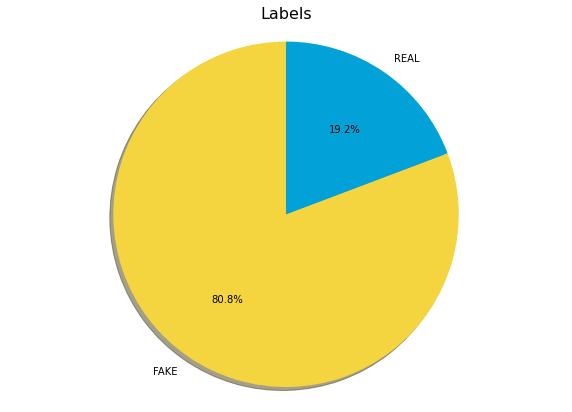

In [79]:
labels = 'FAKE', 'REAL'
sizes = [meta[meta.label == 'FAKE'].label.count(), meta[meta.label == 'REAL'].label.count()]

fig1, ax1 = plt.subplots(figsize=(10,7))
ax1.pie(sizes, labels=labels, autopct='%1.1f%%',
        shadow=True, startangle=90, colors=['#f4d53f', '#02a1d8'])
ax1.axis('equal') 
plt.title('Labels', fontsize=16)

plt.show()

In [123]:
def get_frame(filename):
   
    cap = cv2.VideoCapture(filename)
    ret, frame = cap.read()

    # Our operations on the frame come here
    image = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    
    # When everything done, release the capture
    cap.release()
    cv2.destroyAllWindows()
    
    return image

def get_label(filename, meta):
   
    video_id = filename.split('/')[-1]
    return meta.loc[video_id].label

def get_original_filename(filename, meta):
   
    video_id = filename.split('/')[-1]
    original_id = meta.loc[video_id].original
    
    return original_id

def visualize_frame(filename, meta, train = True):
   
    # get the 1st frame of the video
    image = get_frame(filename)

    # Display the 1st frame of the video
    fig, axs = plt.subplots(1,3, figsize=(20,7))
    axs[0].imshow(image) 
    axs[0].axis('off')
    axs[0].set_title('Original frame')
    
    face_cascade = cv2.CascadeClassifier('/Users/utkarshkumarsharma/haarcascades/haarcascade_frontalface_default.xml')

    in a given image
    faces = face_cascade.detectMultiScale(image,1.2,3)

    
    image_with_detections = image.copy()

    for (x,y,w,h) in faces:
        e resolution
        cv2.rectangle(image_with_detections,(x,y),(x+w,y+h),(255,0,0),3)

    axs[1].imshow(image_with_detections)
    axs[1].axis('off')
    axs[1].set_title('Highlight faces')
    
    crop_img = image.copy()
    for (x,y,w,h) in faces:
        crop_img = image[y:y+h, x:x+w]
        break;
        
    axs[2].imshow(crop_img)
    axs[2].axis('off')
    axs[2].set_title('Zoom-in face')
    
    if train:
        plt.suptitle('Image {image} label: {label}'.format(image = filename.split('/')[-1], label=get_label(filename, meta)))
    else:
        plt.suptitle('Image {image}'.format(image = filename.split('/')[-1]))
    plt.show()

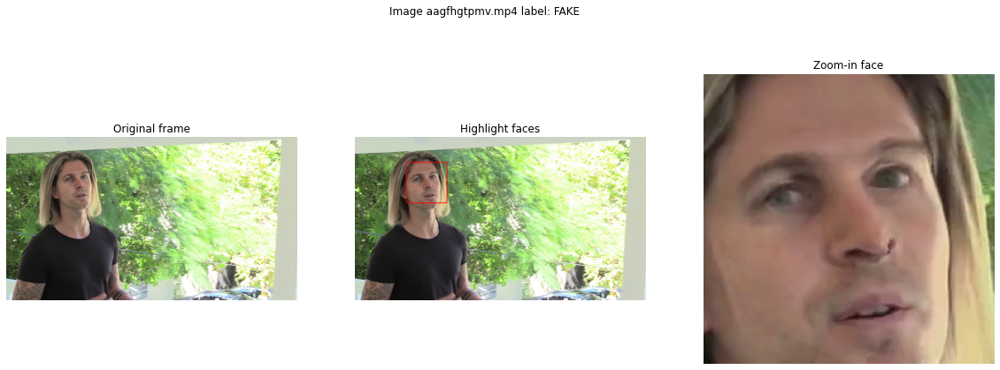

In [125]:
visualize_frame(train_fns[0], meta)

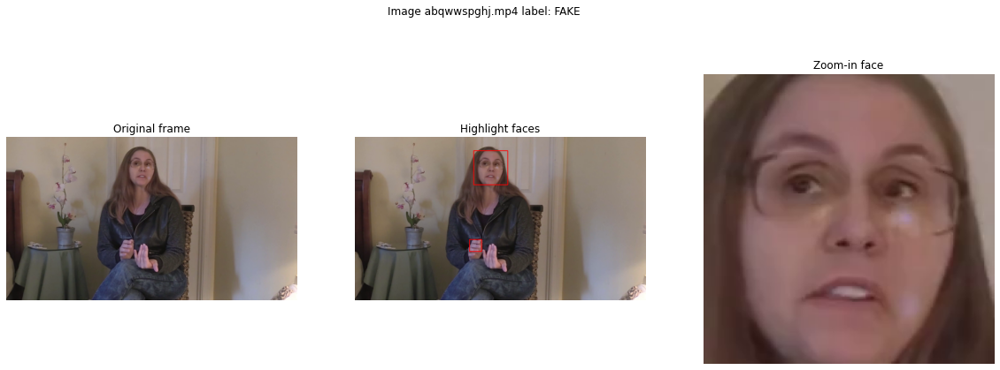

In [126]:
visualize_frame(train_fns[4], meta)

In [128]:
def get_frames(filename):
    
    frames = []
    cap = cv2.VideoCapture(filename)

    while(cap.isOpened()):
        ret, frame = cap.read()
                
        if not ret:
            break;
            
        image = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        frames.append(image)

    cap.release()
    cv2.destroyAllWindows()
    return frames

def create_animation(filename):
   
    fig = plt.figure(figsize=(10,7))
    frames = get_frames(filename)

    ims = []
    for frame in frames:
        im = plt.imshow(frame, animated=True)
        ims.append([im])

    animation = ArtistAnimation(fig, ims, interval=30, repeat_delay=1000)
    plt.show()
    return animation

def visualize_several_frames(frames, step=100, cols = 3, title=''):
   
    n_frames = len(range(0, len(frames), step))
    rows = n_frames // cols
    if n_frames % cols > 0:
        rows = rows + 1
    
    fig, axs = plt.subplots(rows, cols, figsize=(20,20))
    for i in range(0, n_frames):
        frame = frames[i]
        
        r = i // cols
        c = i % cols
        
        axs[r,c].imshow(frame)
        axs[r,c].axis('off')
        axs[r,c].set_title(str(i))
        
    plt.suptitle(title)
    plt.show()

In [109]:
def get_frames_zoomed(filename):
    
    frames = []
    cap = cv2.VideoCapture(filename)
    
    face_cascade = cv2.CascadeClassifier('/Users/utkarshkumarsharma/haarcascades/haarcascade_frontalface_default.xml')

    while(cap.isOpened()):
        ret, frame = cap.read()
                
        if not ret:
            break;
            
        image = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        
        faces = face_cascade.detectMultiScale(image, 1.2, 3)
        image_with_detections = image.copy()

        crop_img = image.copy()
        for (x,y,w,h) in faces:
            crop_img = image[y:y+h, x:x+w]
            break;
        
        frames.append(crop_img)

    cap.release()
    cv2.destroyAllWindows()
    return frames

def create_animation_zoomed(filename):
    filename - filename of the video

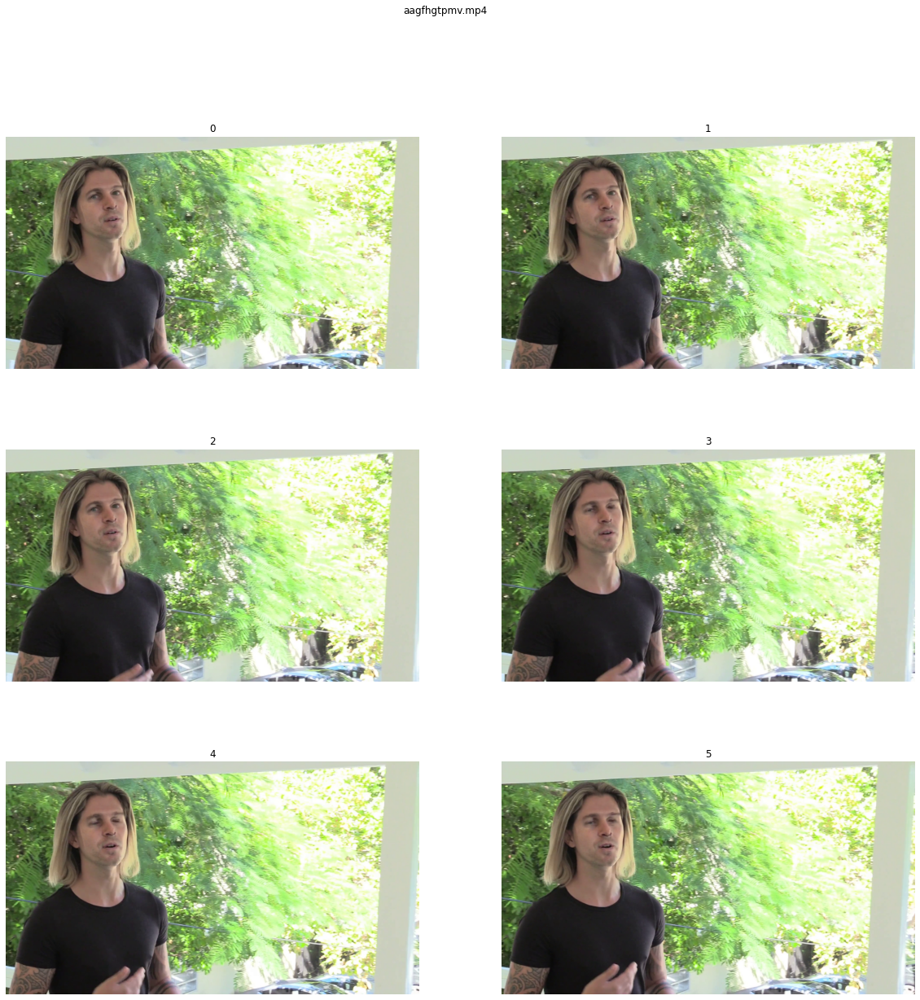

In [129]:
frames = get_frames(train_fns[0])
visualize_several_frames(frames, step=50, cols = 2, title=train_fns[0].split('/')[-1])

In [134]:
def get_frames_zoomed(filename):
   
    frames = []
    cap = cv2.VideoCapture(filename)
    
    face_cascade = cv2.CascadeClassifier('/Users/utkarshkumarsharma/haarcascades/haarcascade_frontalface_default.xml')

    while(cap.isOpened()):
        ret, frame = cap.read()
                
        if not ret:
            break;
            
        image = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        
        faces = face_cascade.detectMultiScale(image, 1.2, 3)
        image_with_detections = image.copy()

        crop_img = image.copy()
        for (x,y,w,h) in faces:
            crop_img = image[y:y+h, x:x+w]
            break;
        
        frames.append(crop_img)

    cap.release()
    cv2.destroyAllWindows()
    return frames

def create_animation_zoomed(filename):
   
    fig, ax = plt.subplots(1,1, figsize=(10,7))
    frames = get_frames_zoomed(filename)

    def update(frame_number):
        plt.axis('off')
        plt.imshow(frames[frame_number])

    animation = FuncAnimation(fig, update, interval=30, repeat=True)
    return animation

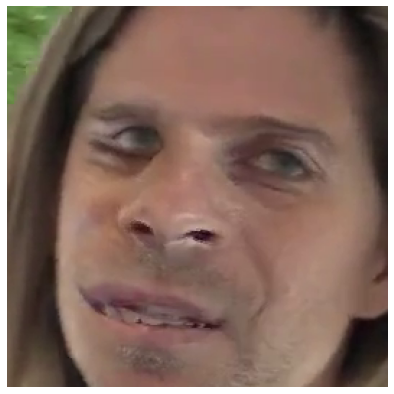

In [135]:
animation = create_animation_zoomed(train_fns[0])
HTML(animation.to_jshtml())

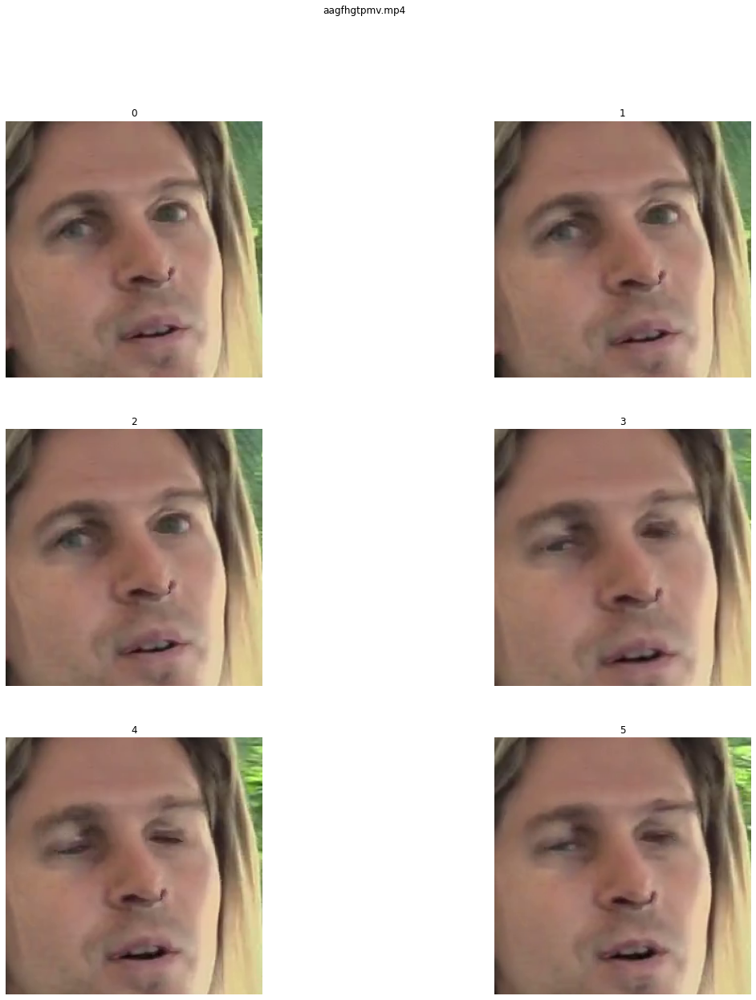

In [136]:
frames_face = get_frames_zoomed(train_fns[0])
visualize_several_frames(frames_face, step=55, cols = 2, title=train_fns[0].split('/')[-1])

In [145]:
def get_similarity_scores(frames):
    
    scores = []
    for i in range(1, len(frames)):
        frame = frames[i]
        prev_frame = frames[i-1]
        
        if frame.shape[0] != prev_frame.shape[0]:
            if  frame.shape[0] > prev_frame.shape[0]:
                frame = frame[:prev_frame.shape[0], :prev_frame.shape[0], :]
            else:
                prev_frame = prev_frame[:frame.shape[0], :frame.shape[0], :]
        
        (score, diff) = compare_ssim(frame, prev_frame, full=True, multichannel=True)
        scores.append(score)
    return scores

def plot_scores(scores):
    
    plt.figure(figsize=(12,7))
    plt.plot(scores)
    plt.title('Similarity Scores')
    plt.show()

<ipython-input-145-ce0ac2d75050>:16: UserWarning: DEPRECATED: skimage.measure.compare_ssim has been moved to skimage.metrics.structural_similarity. It will be removed from skimage.measure in version 0.18.
  (score, diff) = compare_ssim(frame, prev_frame, full=True, multichannel=True)


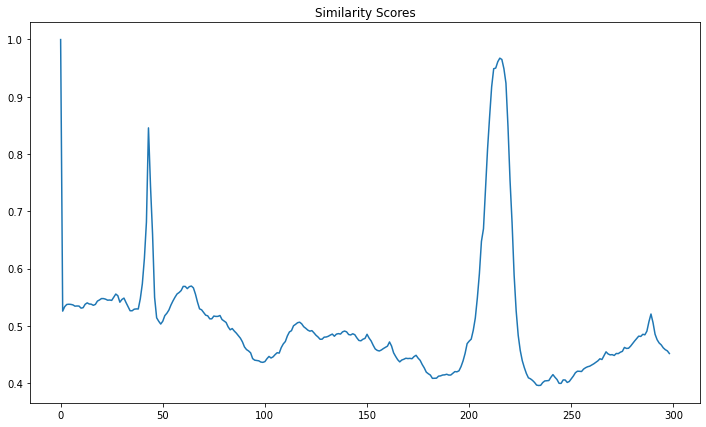

In [146]:
scores = get_similarity_scores(frames)
plot_scores(scores)